## LEVEL 2

## Task 1 : Restaurant Ratings

## Analyze the distribution of aggregate ratings and determine the most common rating range

In [11]:
import pandas as pd

df = pd.read_csv('restaurants.csv')
print(df['Aggregate rating'].dtype)

float64


In [12]:
print(df['Aggregate rating'].describe())

count    9551.000000
mean        2.666370
std         1.516378
min         0.000000
25%         2.500000
50%         3.200000
75%         3.700000
max         4.900000
Name: Aggregate rating, dtype: float64


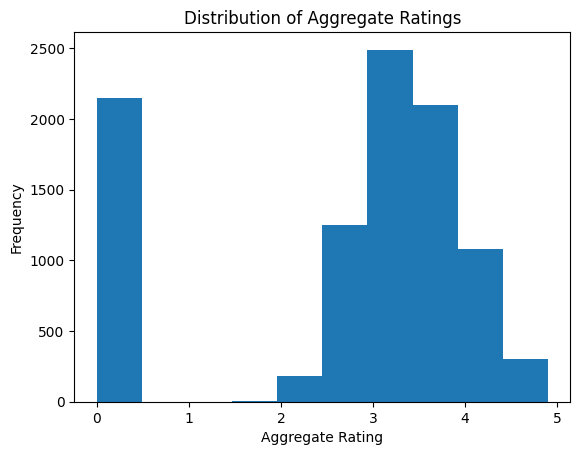

In [13]:
import matplotlib.pyplot as plt

plt.hist(df['Aggregate rating'], bins=10)
plt.xlabel('Aggregate Rating')
plt.ylabel('Frequency')
plt.title('Distribution of Aggregate Ratings')
plt.show()

In [14]:
rating_bins = [0, 1, 2, 3, 4, 5]
rating_labels = ['0-1', '1-2', '2-3', '3-4', '4-5']

df['Rating Range'] = pd.cut(df['Aggregate rating'], bins=rating_bins, labels=rating_labels)

rating_range_counts = df['Rating Range'].value_counts()
print(rating_range_counts)

Rating Range
3-4    4388
2-3    1891
4-5    1114
1-2      10
0-1       0
Name: count, dtype: int64


In [15]:
rating_range_percentages = df['Rating Range'].value_counts(normalize=True) * 100
print(rating_range_percentages)

Rating Range
3-4    59.273268
2-3    25.543699
4-5    15.047954
1-2     0.135080
0-1     0.000000
Name: proportion, dtype: float64


## Calculate the average number of votes received by restaurants.

In [16]:
avg_votes = df['Votes'].mean()

print(f"The average number of votes received by restaurants is: {avg_votes:.2f}")

The average number of votes received by restaurants is: 156.91


In [17]:
avg_votes_nonzero = df[df['Votes'] > 0]['Votes'].mean()

print(f"The average number of votes received by restaurants (excluding zero votes) is: {avg_votes_nonzero:.2f}")

The average number of votes received by restaurants (excluding zero votes) is: 177.21


## Task 2 : Cuisine Combination

## Identify the most common combinations of cuisines in the dataset.

In [20]:
cuisines_split = df['Cuisines'].str.split(',', expand=True).stack().reset_index(drop=True)

cuisine_freq = cuisines_split.value_counts()

print("Frequency of each cuisine:")
print(cuisine_freq)

cuisine_combinations = df['Cuisines'].value_counts()

print("\nFrequency of each combination of cuisines:")
print(cuisine_combinations)

Frequency of each cuisine:
North Indian      2992
 Chinese          1880
 Fast Food        1314
 North Indian      968
Chinese            855
                  ... 
 Ramen               1
Indonesian           1
 Bubble Tea          1
Kiwi                 1
 World Cuisine       1
Name: count, Length: 249, dtype: int64

Frequency of each combination of cuisines:
Cuisines
North Indian                                             936
North Indian, Chinese                                    511
Chinese                                                  354
Fast Food                                                354
North Indian, Mughlai                                    334
                                                        ... 
Bengali, Fast Food                                         1
North Indian, Rajasthani, Asian                            1
Chinese, Thai, Malaysian, Indonesian                       1
Bakery, Desserts, North Indian, Bengali, South Indian      1
Italian, World Cui

In [21]:
N = 10  # Change this to the desired number of combinations
top_cuisine_combinations = cuisine_combinations.nlargest(N)

print(f"\nTop {N} most common combinations of cuisines:")
print(top_cuisine_combinations)


Top 10 most common combinations of cuisines:
Cuisines
North Indian                      936
North Indian, Chinese             511
Chinese                           354
Fast Food                         354
North Indian, Mughlai             334
Cafe                              299
Bakery                            218
North Indian, Mughlai, Chinese    197
Bakery, Desserts                  170
Street Food                       149
Name: count, dtype: int64


## Determine if certain cuisine combinations tend to have higher ratings

In [56]:
import pandas as pd
from itertools import combinations

df = pd.read_csv('restaurants.csv')

df['Cuisines'] = df['Cuisines'].str.split(',')
df['Cuisines'] = df['Cuisines'].apply(lambda x: x if isinstance(x, list) else [])
combination_ratings = []

for _, row in df.iterrows():
    cuisines = row['Cuisines']
    rating = row['Aggregate rating']
    for r in range(1, len(cuisines) + 1):
        for combo in combinations(cuisines, r):
            combination_ratings.append((combo, rating))

comb_df = pd.DataFrame(combination_ratings, columns=['Combination', 'Rating'])

avg_ratings = comb_df.groupby('Combination')['Rating'].mean().reset_index()

avg_ratings = avg_ratings.sort_values(by='Rating', ascending=False)

print(avg_ratings.head(10))  # Display the top 10 combinations


                           Combination  Rating
4155                  (American,  Tea)     4.9
3965            (American,  Caribbean)     4.9
313                ( Bar Food,  Steak)     4.9
4647       (Burger,  Bar Food,  Steak)     4.9
251                  ( BBQ,  Sandwich)     4.9
3914       (American,  BBQ,  Sandwich)     4.9
6692       (European,  Asian,  Indian)     4.9
8064          (Mexican,  Healthy Food)     4.9
3958       (American,  Burger,  Grill)     4.9
3966  (American,  Caribbean,  Seafood)     4.9


## Task 3 : Geographic Analysis

## Plot the locations of restaurants on a map using longitude and latitude coordinates.

In [60]:
import pandas as pd
import folium

# Load the dataset
df = pd.read_csv('restaurants.csv')
print(df.head())

map_center = [df['Latitude'].mean(), df['Longitude'].mean()]
mymap = folium.Map(location=map_center, zoom_start=12)

popup_column = 'Name' if 'Name' in df.columns else df.columns[0]

# Add restaurant locations to the map
for idx, row in df.iterrows():
    folium.Marker(
        location=[row['Latitude'], row['Longitude']],
        popup=row[popup_column],  # Use the identified column for popup
    ).add_to(mymap)

# Save the map to an HTML file
mymap.save('restaurant_locations_map.html')
mymap


   Restaurant ID         Restaurant Name  Country Code              City  \
0        6317637        Le Petit Souffle           162       Makati City   
1        6304287        Izakaya Kikufuji           162       Makati City   
2        6300002  Heat - Edsa Shangri-La           162  Mandaluyong City   
3        6318506                    Ooma           162  Mandaluyong City   
4        6314302             Sambo Kojin           162  Mandaluyong City   

                                             Address  \
0  Third Floor, Century City Mall, Kalayaan Avenu...   
1  Little Tokyo, 2277 Chino Roces Avenue, Legaspi...   
2  Edsa Shangri-La, 1 Garden Way, Ortigas, Mandal...   
3  Third Floor, Mega Fashion Hall, SM Megamall, O...   
4  Third Floor, Mega Atrium, SM Megamall, Ortigas...   

                                     Locality  \
0   Century City Mall, Poblacion, Makati City   
1  Little Tokyo, Legaspi Village, Makati City   
2  Edsa Shangri-La, Ortigas, Mandaluyong City   
3      SM 

## Identify any patterns or clusters of restaurants in specific areas.
 

In [61]:
import pandas as pd
import numpy as np
from sklearn.cluster import DBSCAN
import folium

# Load the dataset
df = pd.read_csv('restaurants.csv')

# Display the first few rows to understand the structure of the dataset
print(df.head())

# Extract latitude and longitude
coords = df[['Latitude', 'Longitude']].dropna().values

# Perform clustering with DBSCAN
# Note: The eps parameter depends on the scale of your data and needs to be tuned
db = DBSCAN(eps=0.01, min_samples=5).fit(coords)
labels = db.labels_

# Add the cluster labels to the DataFrame
df['Cluster'] = -1  # Initialize all to noise
df.loc[df[['Latitude', 'Longitude']].dropna().index, 'Cluster'] = labels

# Create a map centered around the mean latitude and longitude
map_center = [df['Latitude'].mean(), df['Longitude'].mean()]
mymap = folium.Map(location=map_center, zoom_start=12)

# Define colors for clusters
colors = ['red', 'blue', 'green', 'purple', 'orange', 'darkred', 'lightred',
          'beige', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple', 'white', 'pink', 'lightblue', 'lightgreen',
          'gray', 'black', 'lightgray']

# Add restaurant locations to the map with different colors for each cluster
for idx, row in df.iterrows():
    cluster_id = row['Cluster']
    if cluster_id == -1:  # Noise points
        color = 'gray'
    else:
        color = colors[cluster_id % len(colors)]
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=3,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.6,
        popup=row.get('Name', 'Restaurant')  # Use 'Name' if available, otherwise 'Restaurant'
    ).add_to(mymap)

# Save the map to an HTML file
mymap.save('restaurant_clusters_map.html')

# Display the map in a Jupyter notebook (optional)
mymap


   Restaurant ID         Restaurant Name  Country Code              City  \
0        6317637        Le Petit Souffle           162       Makati City   
1        6304287        Izakaya Kikufuji           162       Makati City   
2        6300002  Heat - Edsa Shangri-La           162  Mandaluyong City   
3        6318506                    Ooma           162  Mandaluyong City   
4        6314302             Sambo Kojin           162  Mandaluyong City   

                                             Address  \
0  Third Floor, Century City Mall, Kalayaan Avenu...   
1  Little Tokyo, 2277 Chino Roces Avenue, Legaspi...   
2  Edsa Shangri-La, 1 Garden Way, Ortigas, Mandal...   
3  Third Floor, Mega Fashion Hall, SM Megamall, O...   
4  Third Floor, Mega Atrium, SM Megamall, Ortigas...   

                                     Locality  \
0   Century City Mall, Poblacion, Makati City   
1  Little Tokyo, Legaspi Village, Makati City   
2  Edsa Shangri-La, Ortigas, Mandaluyong City   
3      SM 

 ## Task 4 : Restaurant Chains

## Identify if there are any restaurant chains present in the dataset.

In [64]:
print(df.head())

# Count the occurrences of each restaurant name
name_counts = df['Restaurant Name'].value_counts()

# Identify potential chains (names that appear more than once)
chains = name_counts[name_counts > 1]

# Display the potential chains
print("Potential Restaurant Chains:")
print(chains)


   Restaurant ID         Restaurant Name  Country Code              City  \
0        6317637        Le Petit Souffle           162       Makati City   
1        6304287        Izakaya Kikufuji           162       Makati City   
2        6300002  Heat - Edsa Shangri-La           162  Mandaluyong City   
3        6318506                    Ooma           162  Mandaluyong City   
4        6314302             Sambo Kojin           162  Mandaluyong City   

                                             Address  \
0  Third Floor, Century City Mall, Kalayaan Avenu...   
1  Little Tokyo, 2277 Chino Roces Avenue, Legaspi...   
2  Edsa Shangri-La, 1 Garden Way, Ortigas, Mandal...   
3  Third Floor, Mega Fashion Hall, SM Megamall, O...   
4  Third Floor, Mega Atrium, SM Megamall, Ortigas...   

                                     Locality  \
0   Century City Mall, Poblacion, Makati City   
1  Little Tokyo, Legaspi Village, Makati City   
2  Edsa Shangri-La, Ortigas, Mandaluyong City   
3      SM 

## Analyze the ratings and popularity of different restaurant chains.


               Restaurant Name  Aggregate rating  Votes
629           Talaga Sampireun             4.900   5514
8      AB's Absolute Barbecues             4.850   3151
589           Silantro Fil-Mex             4.850   1364
7    AB's - Absolute Barbecues             4.825  13400
449         Naturals Ice Cream             4.800   3094
..                         ...               ...    ...
440           Murliwala Bakers             0.000      0
538        Rajdhani Restaurant             0.000      0
616                Street Cafe             0.000      0
645              The Big Scoop             0.000      0
713               Whatslife.in             0.000      0

[734 rows x 3 columns]


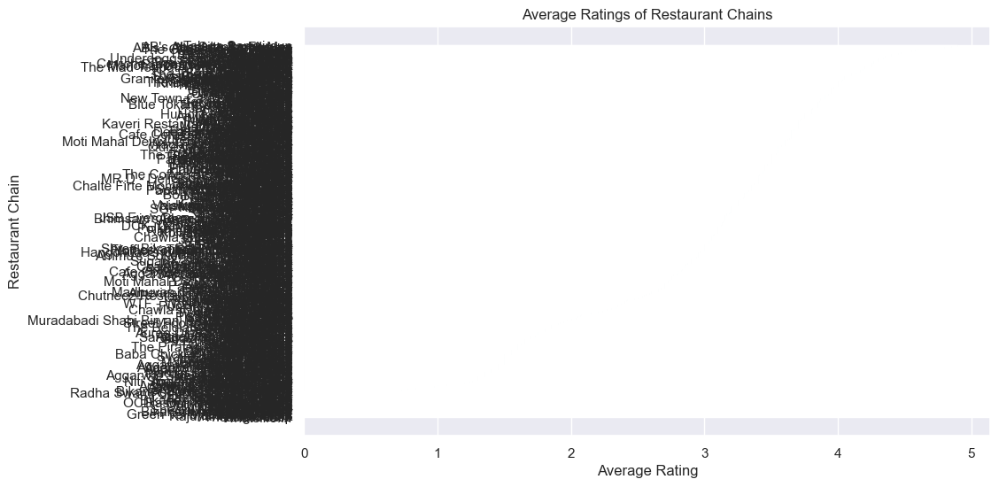

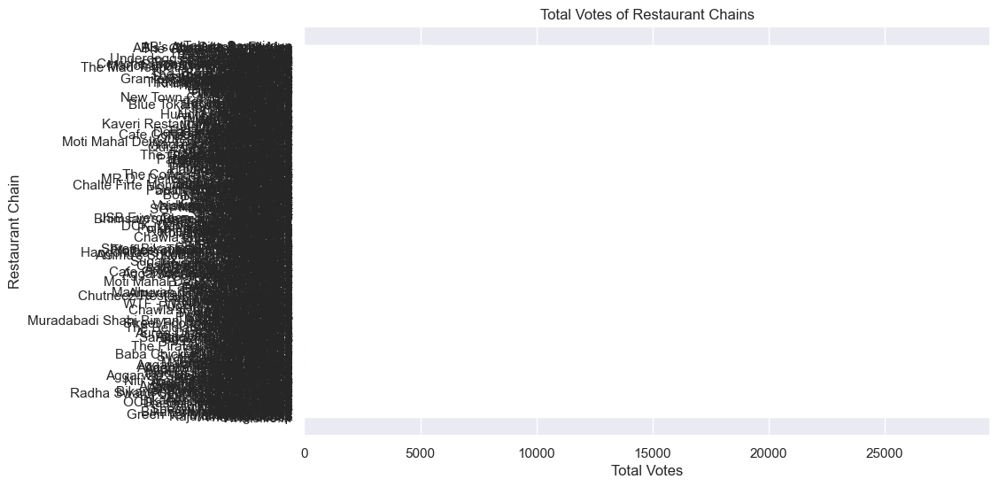

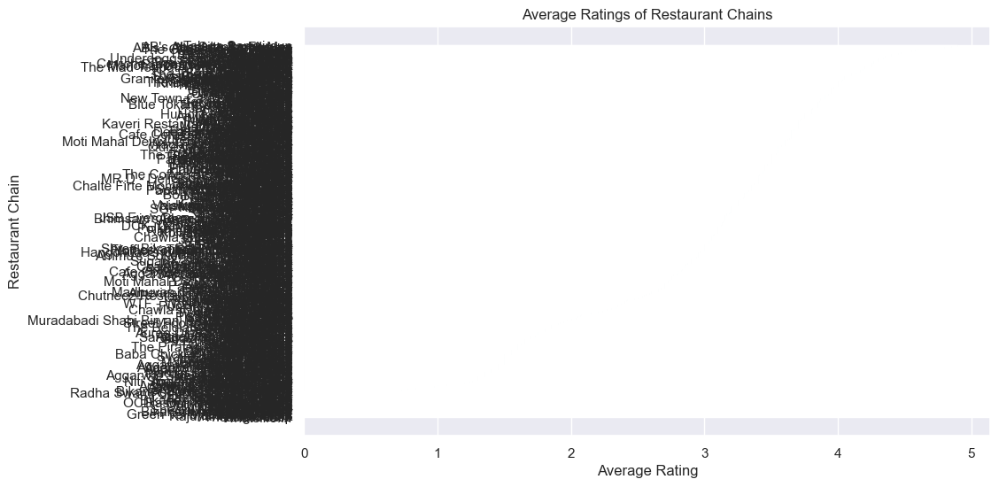

In [68]:
import matplotlib.pyplot as plt
import warnings

warnings.filterwarnings("ignore", category=UserWarning)

name_counts = df['Restaurant Name'].value_counts()
chains = name_counts[name_counts > 1].index

# Filter the dataset to include only chains
chains_df = df[df['Restaurant Name'].isin(chains)]

# Calculate average ratings and total votes for each chain
chain_stats = chains_df.groupby('Restaurant Name').agg({
    'Aggregate rating': 'mean',
    'Votes': 'sum'
}).reset_index()

# Sort chains by average rating and total votes for better visualization
chain_stats = chain_stats.sort_values(by=['Aggregate rating', 'Votes'], ascending=[False, False])

# Display the top chains
print(chain_stats)

# Plot average ratings of top chains
plt.figure(figsize=(10, 6))
plt.barh(chain_stats['Restaurant Name'], chain_stats['Aggregate rating'], color='skyblue')
plt.xlabel('Average Rating')
plt.ylabel('Restaurant Chain')
plt.title('Average Ratings of Restaurant Chains')
plt.gca().invert_yaxis()
plt.show()

# Plot total votes of top chains
plt.figure(figsize=(10, 6))
plt.barh(chain_stats['Restaurant Name'], chain_stats['Votes'], color='lightgreen')
plt.xlabel('Total Votes')
plt.ylabel('Restaurant Chain')
plt.title('Total Votes of Restaurant Chains')
plt.gca().invert_yaxis()
plt.show()

# Before plotting, specify a font that supports the required characters
plt.rcParams['font.family'] = 'Arial'

plt.figure(figsize=(10, 6))
plt.barh(chain_stats['Restaurant Name'], chain_stats['Aggregate rating'], color='skyblue')
plt.xlabel('Average Rating')
plt.ylabel('Restaurant Chain')
plt.title('Average Ratings of Restaurant Chains')
plt.gca().invert_yaxis()
plt.show()

